# PREDICTING CAR ACCIDENT SEVERITY

## IBM Applied Data Science Capstone Project



## 1. Introduction / Business Problem

In a big city where car accidents happen all the time, it can be a challenge to deploy necessary number or type of personnel on time with the limited numbers of personnel on our disposal.

The idea is to classify the severity of a car accident, in this case we will use two level of severity, 1 for Property Damage Only Collision and 2 for Injury Collision. The severity prediction will be based on the information received at the time an accident is reported.

With this simplification of early accident classification, the Dispatch Center can decide which personnel should be dispatched for the accident. For example, for accident with severity of 1 Property Damage Only Collision, the healthcare personnels are not needed on site, and they can be allocated to another injury related accident.

## 2. Data

The data that will be used is to approach the problem is the sample data set from:

https://s3.us.cloud-object-storage.appdomain.cloud/cf-courses-data/CognitiveClass/DP0701EN/version-2/Data-Collisions.csv. 

This is a Seattle's car accident data from 2004 to 2020 which contains a number of information for each accident, such as the time, location, and the number of people / vehicle involved in each accident. Based on this historical data, we will try to build a model that is able to predict the severity of an accident based on the initial data collected from the accident site.

The data itself containing 1 target column & 37 feature columns, some of them are not neccessarily useful for us in building the model.

The target column is **SEVERITYCODE** which contains the severity classification. We have 2 different severity values here:

- 1 Property Damage Only Collision
- 2 Injury Collision

These are the feature columns.

    'X', 'Y', 'OBJECTID', 'INCKEY', 'COLDETKEY', 'REPORTNO',
    'STATUS', 'ADDRTYPE', 'INTKEY', 'LOCATION', 'EXCEPTRSNCODE',
    'EXCEPTRSNDESC', 'SEVERITYCODE.1', 'SEVERITYDESC', 'COLLISIONTYPE',
    'PERSONCOUNT', 'PEDCOUNT', 'PEDCYLCOUNT', 'VEHCOUNT', 'INCDATE',
    'INCDTTM', 'JUNCTIONTYPE', 'SDOT_COLCODE', 'SDOT_COLDESC',
    'INATTENTIONIND', 'UNDERINFL', 'WEATHER', 'ROADCOND', 'LIGHTCOND',
    'PEDROWNOTGRNT', 'SDOTCOLNUM', 'SPEEDING', 'ST_COLCODE', 'ST_COLDESC',
    'SEGLANEKEY', 'CROSSWALKKEY', 'HITPARKEDCAR'

The explanation for each column can be found in:

https://s3.us.cloud-object-storage.appdomain.cloud/cf-courses-data/CognitiveClass/DP0701EN/version-2/Metadata.pdf

We exclude the columns that are entered by the state as they won't be available in the initial report ('PEDCOUNT', 'PEDCYLCOUNT', 'VEHCOUNT', 'INJURIES', 'SERIOUSINJURIES', 'FATALITIES'). We also exclude the 'LOCATION' column as this is a free text column and is already represented by the coordinates('X', 'Y').

We are going to use the following feature columns in our initial model and adding or remove the features as necessary as we build the model.

- X                 - Double    - Longitude
- Y                 - Double    - Latitude                
- ADDRTYPE          - Text, 12  - Collision address type: Alley, Block, Intersection
- INTKEY            - Double    - Key that corresponds to the intersection associated with a collision 
- PERSONCOUNT       - Double    - The total number of people involved in the collision
- SDOT_COLCODE      - Text, 10  - A code given to the collision by SDOT.
- INATTENTIONIND    - Text, 1   - Whether or not collision was due to inattention. (Y/N) 
- UNDERINFL         - Text, 10  - Whether or not a driver involved was under the influence of drugs or alcohol. 
- WEATHER           - Text, 300 - A description of the weather conditions during the time of the collision. 
- ROADCOND          - Text, 300 - The condition of the road during the collision. 
- LIGHTCOND         - Text, 300 - The light conditions during the collision. 
- SPEEDING          - Text, 1   - Whether or not speeding was a factor in the collision. (Y/N)
- ST_COLCODE        - Text, 10  - A code provided by the state that describes the collision. See the State Collision Code Dictionary in the Metadata file. 
- SEGLANEKEY        - Long      - A key for the lane segment in which the collision occurred. 
- CROSSWALKKEY      - Long      - A key for the crosswalk at which the collision occurred. 
- HITPARKEDCAR      - Text, 1   - Whether or not the collision involved hitting a parked car. (Y/N) 

### 2.a. Importing Data

In [410]:
path = "./DATA/Data-Collisions.csv"

In [411]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [412]:
data = pd.read_csv(path)

In [413]:
data.head()

,SEVERITYCODE,X,Y,OBJECTID,INCKEY,COLDETKEY,REPORTNO,STATUS,ADDRTYPE,INTKEY,...,ROADCOND,LIGHTCOND,PEDROWNOTGRNT,SDOTCOLNUM,SPEEDING,ST_COLCODE,ST_COLDESC,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR
0,2,-122.323148,47.703140,1,1307,1307,3502005,Matched,Intersection,37475.0,...,Wet,Daylight,NaN,NaN,NaN,10,Entering at angle,0,0,N
1,1,-122.347294,47.647172,2,52200,52200,2607959,Matched,Block,NaN,...,Wet,Dark - Street Lights On,NaN,6354039.0,NaN,11,From same direction - both going straight - bo...,0,0,N
2,1,-122.334540,47.607871,3,26700,26700,1482393,Matched,Block,NaN,...,Dry,Daylight,NaN,4323031.0,NaN,32,One parked--one moving,0,0,N
3,1,-122.334803,47.604803,4,1144,1144,3503937,Matched,Block,NaN,...,Dry,Daylight,NaN,NaN,NaN,23,From same direction - all others,0,0,N
4,2,-122.306426,47.545739,5,17700,17700,1807429,Matched,Intersection,34387.0,...,Wet,Daylight,NaN,4028032.0,NaN,10,Entering at angle,0,0,N


In [414]:
data.columns

Index([&#39;SEVERITYCODE&#39;, &#39;X&#39;, &#39;Y&#39;, &#39;OBJECTID&#39;, &#39;INCKEY&#39;, &#39;COLDETKEY&#39;, &#39;REPORTNO&#39;,
       &#39;STATUS&#39;, &#39;ADDRTYPE&#39;, &#39;INTKEY&#39;, &#39;LOCATION&#39;, &#39;EXCEPTRSNCODE&#39;,
       &#39;EXCEPTRSNDESC&#39;, &#39;SEVERITYCODE.1&#39;, &#39;SEVERITYDESC&#39;, &#39;COLLISIONTYPE&#39;,
       &#39;PERSONCOUNT&#39;, &#39;PEDCOUNT&#39;, &#39;PEDCYLCOUNT&#39;, &#39;VEHCOUNT&#39;, &#39;INCDATE&#39;,
       &#39;INCDTTM&#39;, &#39;JUNCTIONTYPE&#39;, &#39;SDOT_COLCODE&#39;, &#39;SDOT_COLDESC&#39;,
       &#39;INATTENTIONIND&#39;, &#39;UNDERINFL&#39;, &#39;WEATHER&#39;, &#39;ROADCOND&#39;, &#39;LIGHTCOND&#39;,
       &#39;PEDROWNOTGRNT&#39;, &#39;SDOTCOLNUM&#39;, &#39;SPEEDING&#39;, &#39;ST_COLCODE&#39;, &#39;ST_COLDESC&#39;,
       &#39;SEGLANEKEY&#39;, &#39;CROSSWALKKEY&#39;, &#39;HITPARKEDCAR&#39;],
      dtype=&#39;object&#39;)

In [415]:
data.info()

&lt;class &#39;pandas.core.frame.DataFrame&#39;&gt;
RangeIndex: 194673 entries, 0 to 194672
Data columns (total 38 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   SEVERITYCODE    194673 non-null  int64  
 1   X               189339 non-null  float64
 2   Y               189339 non-null  float64
 3   OBJECTID        194673 non-null  int64  
 4   INCKEY          194673 non-null  int64  
 5   COLDETKEY       194673 non-null  int64  
 6   REPORTNO        194673 non-null  object 
 7   STATUS          194673 non-null  object 
 8   ADDRTYPE        192747 non-null  object 
 9   INTKEY          65070 non-null   float64
 10  LOCATION        191996 non-null  object 
 11  EXCEPTRSNCODE   84811 non-null   object 
 12  EXCEPTRSNDESC   5638 non-null    object 
 13  SEVERITYCODE.1  194673 non-null  int64  
 14  SEVERITYDESC    194673 non-null  object 
 15  COLLISIONTYPE   189769 non-null  object 
 16  PERSONCOUNT     194673 non-null  int64  
 

We have 194673 car accident records, some of them seems to be missing some information.

In [416]:
len(data)

194673

&lt;AxesSubplot:xlabel=&#39;SEVERITYCODE&#39;, ylabel=&#39;count&#39;&gt;

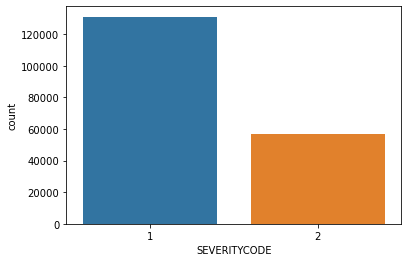

In [417]:
sns.countplot(pre_data['SEVERITYCODE'])

Looks like the dataset is very unbalanced and skewed to SEVERITYCODE 1. We'll need to address this before training our model later.

### 2.b. Create a copy of the data for preprocessing

In [418]:
pre_data = data[['SEVERITYCODE', 'X', 'Y', 'ADDRTYPE', 'INTKEY', 'PERSONCOUNT','SDOT_COLCODE','INATTENTIONIND', 'UNDERINFL', 'WEATHER', 'ROADCOND', 'LIGHTCOND', 'SPEEDING', 'ST_COLCODE', 'SEGLANEKEY', 'CROSSWALKKEY', 'HITPARKEDCAR']].copy()
pre_data.head()

,SEVERITYCODE,X,Y,ADDRTYPE,INTKEY,PERSONCOUNT,SDOT_COLCODE,INATTENTIONIND,UNDERINFL,WEATHER,ROADCOND,LIGHTCOND,SPEEDING,ST_COLCODE,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR
0,2,-122.323148,47.703140,Intersection,37475.0,2,11,NaN,N,Overcast,Wet,Daylight,NaN,10,0,0,N
1,1,-122.347294,47.647172,Block,NaN,2,16,NaN,0,Raining,Wet,Dark - Street Lights On,NaN,11,0,0,N
2,1,-122.334540,47.607871,Block,NaN,4,14,NaN,0,Overcast,Dry,Daylight,NaN,32,0,0,N
3,1,-122.334803,47.604803,Block,NaN,3,11,NaN,N,Clear,Dry,Daylight,NaN,23,0,0,N
4,2,-122.306426,47.545739,Intersection,34387.0,2,11,NaN,0,Raining,Wet,Daylight,NaN,10,0,0,N


### 2.c. Check for Missing Values

In [419]:
pre_data.isna().sum()

SEVERITYCODE           0
X                   5334
Y                   5334
ADDRTYPE            1926
INTKEY            129603
PERSONCOUNT            0
SDOT_COLCODE           0
INATTENTIONIND    164868
UNDERINFL           4884
WEATHER             5081
ROADCOND            5012
LIGHTCOND           5170
SPEEDING          185340
ST_COLCODE            18
SEGLANEKEY             0
CROSSWALKKEY           0
HITPARKEDCAR           0
dtype: int64

### 2.d. Cleaning up the Data

We'll go through each columns one be by one to see if there is any necessary actions needed to clean up the data

#### X, Y

There are 5334 lines without coordinates data.

In [420]:
pre_data[['X', 'Y']].isna().sum()

X    5334
Y    5334
dtype: int64

Let's try to plot the coordinates and differentiate them by their SEVERITYCODE.

&lt;AxesSubplot:xlabel=&#39;X&#39;, ylabel=&#39;Y&#39;&gt;

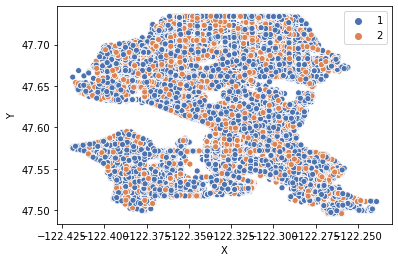

In [421]:
sns.scatterplot(x = pre_data['X'], y = pre_data['Y'], hue = pre_data['SEVERITYCODE'].tolist(), palette = 'deep')

There doesn't seem to be a clear separation between SEVERITYCODE 1 & 2 based on the coordinates. We'll leave them as is for now.

### ADDRTYPE
Text, 12 - Collision address type:
* Alley
* Block
* Intersection

In [422]:
pre_data['ADDRTYPE'].unique()

array([&#39;Intersection&#39;, &#39;Block&#39;, &#39;Alley&#39;, nan], dtype=object)

In [423]:
pre_data['ADDRTYPE'].value_counts(dropna = False)

Block           126926
Intersection     65070
NaN               1926
Alley              751
Name: ADDRTYPE, dtype: int64

&lt;AxesSubplot:xlabel=&#39;ADDRTYPE&#39;, ylabel=&#39;count&#39;&gt;

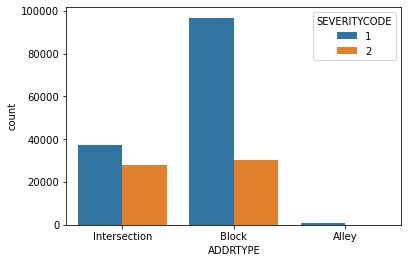

In [424]:
sns.countplot(x = 'ADDRTYPE', data = pre_data, hue = 'SEVERITYCODE')

From the graph above we can see that we have more SEVERITYCODE 1 when the accident is happened in the blocks. 

Further investigation shows that we are missing coordinates data for all Alley accidents.

In [425]:
pre_data[pre_data['ADDRTYPE'] == 'Alley'][['ADDRTYPE', 'X', 'Y']].value_counts()

Series([], dtype: int64)

Since we only have 1926 missing data from ADDRTYPE and 5334 missing data from X and Y, also since ADDRTYPE seems more related to SEVERITYCODE, we'll drop X and Y columns along with the rows with missing ADDRTYPE from our dataframe.

In [426]:
pre_data.drop(['X', 'Y'], axis = 1, inplace = True)
pre_data.dropna(subset = ['ADDRTYPE'], inplace = True)

Let's check our data again.

In [427]:
pre_data.head()

,SEVERITYCODE,ADDRTYPE,INTKEY,PERSONCOUNT,SDOT_COLCODE,INATTENTIONIND,UNDERINFL,WEATHER,ROADCOND,LIGHTCOND,SPEEDING,ST_COLCODE,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR
0,2,Intersection,37475.0,2,11,NaN,N,Overcast,Wet,Daylight,NaN,10,0,0,N
1,1,Block,NaN,2,16,NaN,0,Raining,Wet,Dark - Street Lights On,NaN,11,0,0,N
2,1,Block,NaN,4,14,NaN,0,Overcast,Dry,Daylight,NaN,32,0,0,N
3,1,Block,NaN,3,11,NaN,N,Clear,Dry,Daylight,NaN,23,0,0,N
4,2,Intersection,34387.0,2,11,NaN,0,Raining,Wet,Daylight,NaN,10,0,0,N


In [428]:
pre_data.info()

&lt;class &#39;pandas.core.frame.DataFrame&#39;&gt;
Int64Index: 192747 entries, 0 to 194672
Data columns (total 15 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   SEVERITYCODE    192747 non-null  int64  
 1   ADDRTYPE        192747 non-null  object 
 2   INTKEY          65070 non-null   float64
 3   PERSONCOUNT     192747 non-null  int64  
 4   SDOT_COLCODE    192747 non-null  int64  
 5   INATTENTIONIND  29671 non-null   object 
 6   UNDERINFL       187970 non-null  object 
 7   WEATHER         187776 non-null  object 
 8   ROADCOND        187844 non-null  object 
 9   LIGHTCOND       187689 non-null  object 
 10  SPEEDING        9279 non-null    object 
 11  ST_COLCODE      192729 non-null  object 
 12  SEGLANEKEY      192747 non-null  int64  
 13  CROSSWALKKEY    192747 non-null  int64  
 14  HITPARKEDCAR    192747 non-null  object 
dtypes: float64(1), int64(5), object(9)
memory usage: 23.5+ MB


In [429]:
pre_data.isna().sum()

SEVERITYCODE           0
ADDRTYPE               0
INTKEY            127677
PERSONCOUNT            0
SDOT_COLCODE           0
INATTENTIONIND    163076
UNDERINFL           4777
WEATHER             4971
ROADCOND            4903
LIGHTCOND           5058
SPEEDING          183468
ST_COLCODE            18
SEGLANEKEY             0
CROSSWALKKEY           0
HITPARKEDCAR           0
dtype: int64

#### INTKEY
Double - Key that corresponds to the intersection associated with a collision 

In [430]:
pre_data[['INTKEY']].info()

&lt;class &#39;pandas.core.frame.DataFrame&#39;&gt;
Int64Index: 192747 entries, 0 to 194672
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   INTKEY  65070 non-null  float64
dtypes: float64(1)
memory usage: 2.9 MB


In [431]:
pre_data['INTKEY'].isna().sum()

127677

In [432]:
pre_data['INTKEY'].unique()

array([37475.,    nan, 34387., ..., 36056., 38057., 26005.])

INTKEY refers to intersection number related to the acccident. Since more than half of the information are missing, we'll drop this column

In [433]:
pre_data.drop('INTKEY', axis = 1, inplace = True)

#### PERSONCOUNT
Double - The total number of people involved in the collision

In [434]:
pre_data['PERSONCOUNT'].unique()

array([ 2,  4,  3,  0,  1,  5,  6, 16,  8,  7, 11,  9, 12, 17, 26, 22, 10,
       37, 13, 36, 28, 14, 53, 19, 30, 29, 23, 44, 15, 32, 21, 41, 27, 20,
       35, 43, 81, 18, 25, 48, 24, 34, 57, 39, 47, 54, 31], dtype=int64)

In [435]:
pre_data['PERSONCOUNT'].isna().sum()

0

&lt;AxesSubplot:xlabel=&#39;PERSONCOUNT&#39;, ylabel=&#39;count&#39;&gt;

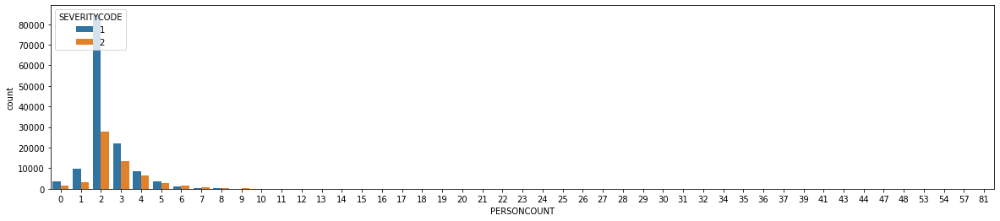

In [436]:
plt.figure(figsize = (20,4))
sns.countplot(pre_data['PERSONCOUNT'], hue = pre_data['SEVERITYCODE'])

PERSONCOUNT looks good, nothing to be done. 

#### SDOT_COLCODE
Text, 10 - A code given to the collision by SDOT.

In [437]:
pre_data['SDOT_COLCODE'].unique()

array([11, 16, 14, 51, 13, 26, 28, 18, 34,  0, 24, 69, 12, 21, 23, 29, 27,
       48, 15, 55, 33, 56, 54, 31, 44, 32, 25, 66, 36, 64, 22, 58, 47, 61,
       35, 53, 46, 68, 52], dtype=int64)

In [438]:
pre_data['SDOT_COLCODE'].isna().sum()

0

&lt;AxesSubplot:xlabel=&#39;SDOT_COLCODE&#39;, ylabel=&#39;count&#39;&gt;

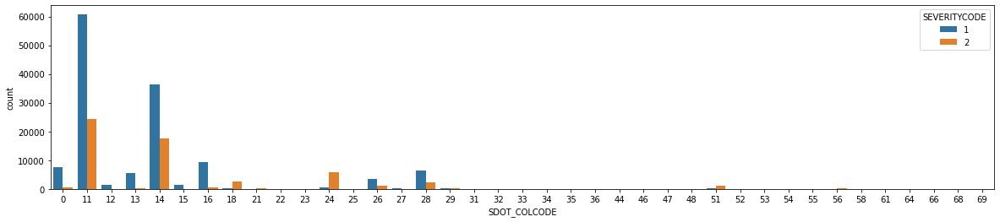

In [439]:
plt.figure(figsize = (20,4))
sns.countplot(pre_data['SDOT_COLCODE'], hue = pre_data['SEVERITYCODE'])

SDOT_COLCODE looks good, nothing to be done. 

#### INATTENTIONIND
Text, 1 - Whether or not collision was due to inattention. (Y/N) 


In [440]:
pre_data['INATTENTIONIND'].unique()

array([nan, &#39;Y&#39;], dtype=object)

In [441]:
pre_data['INATTENTIONIND'].isna().sum()

163076

We'll clean up INATTENTIONIND by replacing NaN with 0 and 'Y' with 1

In [442]:
pre_data['INATTENTIONIND'].replace([np.nan, 'Y'], [0,1], inplace = True)

We can see that more SEVERITYCODE 1 mostly happens when INATTENTIONIND = 0. 

&lt;AxesSubplot:xlabel=&#39;INATTENTIONIND&#39;, ylabel=&#39;count&#39;&gt;

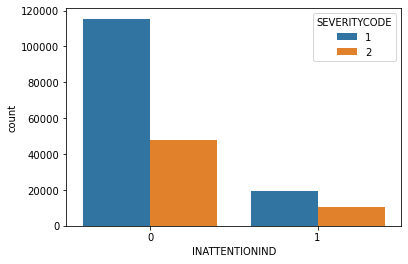

In [443]:
sns.countplot(pre_data['INATTENTIONIND'], hue = pre_data['SEVERITYCODE'])

#### UNDERINFL
Text, 10 - Whether or not a driver involved was under the influence of drugs or alcohol. 

In [444]:
pre_data['UNDERINFL'].unique()

array([&#39;N&#39;, &#39;0&#39;, nan, &#39;1&#39;, &#39;Y&#39;], dtype=object)

In [445]:
pre_data['UNDERINFL'].value_counts(dropna = False)

N      99155
0      79724
Y       5099
NaN     4777
1       3992
Name: UNDERINFL, dtype: int64

We'll clean up UNDERINFL by replaceing [[NaN, 'N', '0']] with 0 and [['Y', '1']] with 1.

In [446]:
pre_data['UNDERINFL'].replace(['N', '0', np.nan, '1', 'Y'], [0, 0, 0, 1, 1], inplace = True)

We can see that more SEVERITYCODE 1 happens when UNDERINFL is 0.

&lt;AxesSubplot:xlabel=&#39;UNDERINFL&#39;, ylabel=&#39;count&#39;&gt;

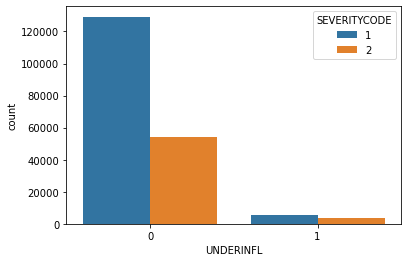

In [447]:
sns.countplot(pre_data['UNDERINFL'], hue = pre_data['SEVERITYCODE'])

#### WEATHER
Text, 300 - A description of the weather conditions during the time of the collision.

In [448]:
pre_data['WEATHER'].unique()


array([&#39;Overcast&#39;, &#39;Raining&#39;, &#39;Clear&#39;, nan, &#39;Unknown&#39;, &#39;Other&#39;, &#39;Snowing&#39;,
       &#39;Fog/Smog/Smoke&#39;, &#39;Sleet/Hail/Freezing Rain&#39;, &#39;Blowing Sand/Dirt&#39;,
       &#39;Severe Crosswind&#39;, &#39;Partly Cloudy&#39;], dtype=object)

In [449]:
pre_data['WEATHER'].value_counts(dropna = False)

Clear                       110626
Raining                      33004
Overcast                     27584
Unknown                      14107
NaN                           4971
Snowing                        902
Other                          798
Fog/Smog/Smoke                 563
Sleet/Hail/Freezing Rain       112
Blowing Sand/Dirt               50
Severe Crosswind                25
Partly Cloudy                    5
Name: WEATHER, dtype: int64

We'll group together NaN, Unknown, Other as Other.

In [450]:
pre_data['WEATHER'].replace([np.nan, 'Unknown'], ['Other', 'Other'], inplace = True)

pre_data['WEATHER'].unique()

array([&#39;Overcast&#39;, &#39;Raining&#39;, &#39;Clear&#39;, &#39;Other&#39;, &#39;Snowing&#39;,
       &#39;Fog/Smog/Smoke&#39;, &#39;Sleet/Hail/Freezing Rain&#39;, &#39;Blowing Sand/Dirt&#39;,
       &#39;Severe Crosswind&#39;, &#39;Partly Cloudy&#39;], dtype=object)

In [451]:
pre_data['WEATHER'].value_counts()

Clear                       110626
Raining                      33004
Overcast                     27584
Other                        19876
Snowing                        902
Fog/Smog/Smoke                 563
Sleet/Hail/Freezing Rain       112
Blowing Sand/Dirt               50
Severe Crosswind                25
Partly Cloudy                    5
Name: WEATHER, dtype: int64

Interestingly, most of the accidents happen during clear weather.

&lt;AxesSubplot:xlabel=&#39;WEATHER&#39;, ylabel=&#39;count&#39;&gt;

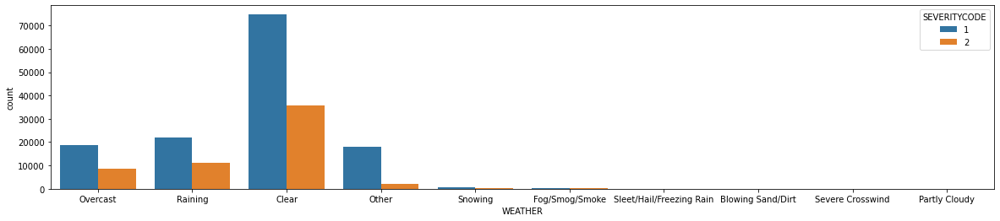

In [452]:
plt.figure(figsize = (20,4))
sns.countplot(pre_data['WEATHER'], hue = pre_data['SEVERITYCODE'])

#### ROADCOND
Text, 300 - The condition of the road during the collision.

In [453]:
pre_data['ROADCOND'].unique()

array([&#39;Wet&#39;, &#39;Dry&#39;, nan, &#39;Unknown&#39;, &#39;Snow/Slush&#39;, &#39;Ice&#39;, &#39;Other&#39;,
       &#39;Sand/Mud/Dirt&#39;, &#39;Standing Water&#39;, &#39;Oil&#39;], dtype=object)

In [454]:
pre_data['ROADCOND'].value_counts(dropna = False)

Dry               123945
Wet                47279
Unknown            14053
NaN                 4903
Ice                 1196
Snow/Slush           997
Other                125
Standing Water       111
Sand/Mud/Dirt         74
Oil                   64
Name: ROADCOND, dtype: int64

There are some values that can be grouped together:
* Wet (Wet, Standing Water)
* Dry
* Other (nan, Unknown, Other)
* Snow/Ice (Snow/Slush, Ice)
* Sand/Mud/Dirt
* Oil

In [455]:
pre_data['ROADCOND'].replace(['Standing Water', np.nan, 'Unknown', 'Snow/Slush', 'Ice'], ['Wet', 'Other', 'Other', 'Snow/Ice', 'Snow/Ice'], inplace = True)

In [456]:
pre_data['ROADCOND'].unique()

array([&#39;Wet&#39;, &#39;Dry&#39;, &#39;Other&#39;, &#39;Snow/Ice&#39;, &#39;Sand/Mud/Dirt&#39;, &#39;Oil&#39;],
      dtype=object)

In [457]:
pre_data['ROADCOND'].value_counts()

Dry              123945
Wet               47390
Other             19081
Snow/Ice           2193
Sand/Mud/Dirt        74
Oil                  64
Name: ROADCOND, dtype: int64

Looks like most of the car accidents happen when the road is dry.

&lt;AxesSubplot:xlabel=&#39;ROADCOND&#39;, ylabel=&#39;count&#39;&gt;

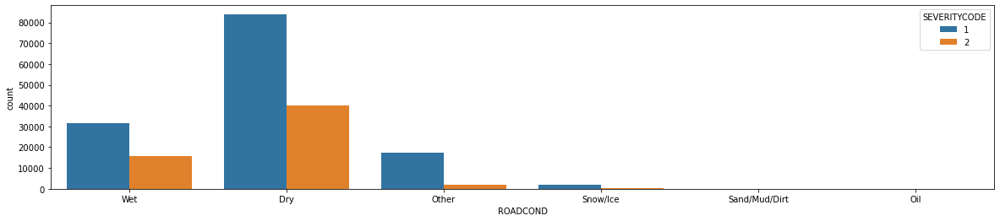

In [458]:
plt.figure(figsize = (20,4))
sns.countplot(pre_data['ROADCOND'], hue = pre_data['SEVERITYCODE'])

#### LIGHTCOND
Text, 300 - The light conditions during the collision. 

In [459]:
pre_data['LIGHTCOND'].unique()

array([&#39;Daylight&#39;, &#39;Dark - Street Lights On&#39;, &#39;Dark - No Street Lights&#39;,
       nan, &#39;Unknown&#39;, &#39;Dusk&#39;, &#39;Dawn&#39;, &#39;Dark - Street Lights Off&#39;,
       &#39;Other&#39;, &#39;Dark - Unknown Lighting&#39;], dtype=object)

In [460]:
pre_data['LIGHTCOND'].value_counts(dropna = False)

Daylight                    115468
Dark - Street Lights On      48301
Unknown                      12616
Dusk                          5856
NaN                           5058
Dawn                          2491
Dark - No Street Lights       1528
Dark - Street Lights Off      1191
Other                          227
Dark - Unknown Lighting         11
Name: LIGHTCOND, dtype: int64

There are some values that can be grouped together:
* Daylight
* Dark (Dark - Street Lights On, Dark - No Street Lights, Dark - Street Lights Off, Dark - Unknown Lighting)
* Dusk
* Dawn
* Other (nan, Other, Unknown)

In [461]:
pre_data['LIGHTCOND'].replace(['Dark - Street Lights On', 'Dark - No Street Lights', 'Dark - Street Lights Off', 'Dark - Unknown Lighting', np.nan, 'Unknown'], 
['Dark', 'Dark', 'Dark', 'Dark', 'Other', 'Other'], inplace = True)

pre_data['LIGHTCOND'].unique()

array([&#39;Daylight&#39;, &#39;Dark&#39;, &#39;Other&#39;, &#39;Dusk&#39;, &#39;Dawn&#39;], dtype=object)

In [462]:
pre_data['LIGHTCOND'].value_counts()

Daylight    115468
Dark         51031
Other        17901
Dusk          5856
Dawn          2491
Name: LIGHTCOND, dtype: int64

It's interesting that most of the accidents happened when the light condition is good (Daylight).

&lt;AxesSubplot:xlabel=&#39;LIGHTCOND&#39;, ylabel=&#39;count&#39;&gt;

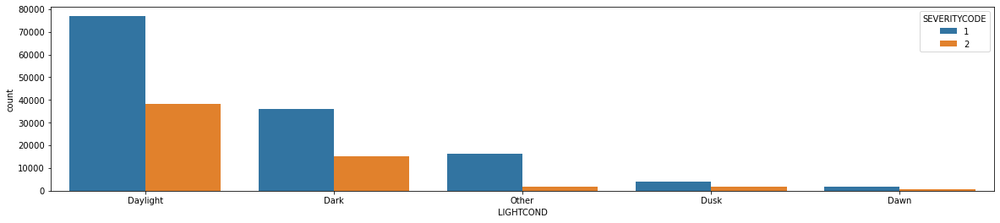

In [463]:
plt.figure(figsize = (20,4))
sns.countplot(pre_data['LIGHTCOND'], hue = pre_data['SEVERITYCODE'])

#### SPEEDING
Text, 1 - Whether or not speeding was a factor in the collision. (Y/N)

In [464]:
pre_data['SPEEDING'].unique()

array([nan, &#39;Y&#39;], dtype=object)

In [465]:
pre_data['SPEEDING'].value_counts(dropna = False)

NaN    183468
Y        9279
Name: SPEEDING, dtype: int64

We'll convert SPEEDING into binary data.

In [466]:
pre_data['SPEEDING'].replace([np.nan, 'Y'], [0, 1], inplace = True)
pre_data['SPEEDING'].unique()

array([0, 1], dtype=int64)

In [467]:
pre_data['SPEEDING'].value_counts(dropna = False)

0    183468
1      9279
Name: SPEEDING, dtype: int64

&lt;AxesSubplot:xlabel=&#39;SPEEDING&#39;, ylabel=&#39;count&#39;&gt;

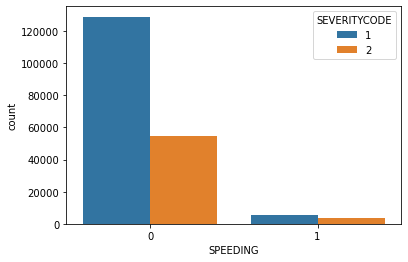

In [468]:
sns.countplot(pre_data['SPEEDING'], hue = pre_data['SEVERITYCODE'])

#### ST_COLCODE
Text, 10 - A code provided by the state that describes the collision.

For more information about these codes, please see the State Collision Code Dictionary. 

In [469]:
pre_data['ST_COLCODE'].unique()

array([&#39;10&#39;, &#39;11&#39;, &#39;32&#39;, &#39;23&#39;, &#39;5&#39;, &#39;22&#39;, &#39;14&#39;, &#39;30&#39;, &#39; &#39;, &#39;28&#39;, &#39;51&#39;,
       &#39;13&#39;, &#39;50&#39;, &#39;12&#39;, &#39;45&#39;, &#39;0&#39;, &#39;20&#39;, &#39;21&#39;, &#39;1&#39;, &#39;52&#39;, &#39;16&#39;, &#39;15&#39;,
       &#39;74&#39;, &#39;81&#39;, &#39;26&#39;, &#39;19&#39;, &#39;2&#39;, &#39;66&#39;, &#39;71&#39;, &#39;3&#39;, &#39;24&#39;, &#39;40&#39;, &#39;57&#39;,
       &#39;6&#39;, &#39;83&#39;, &#39;25&#39;, &#39;27&#39;, &#39;4&#39;, &#39;72&#39;, &#39;29&#39;, &#39;56&#39;, &#39;73&#39;, &#39;41&#39;, &#39;17&#39;,
       &#39;65&#39;, &#39;82&#39;, &#39;67&#39;, &#39;49&#39;, &#39;84&#39;, &#39;31&#39;, &#39;43&#39;, &#39;42&#39;, &#39;48&#39;, &#39;64&#39;, &#39;53&#39;,
       32, 50, 15, 10, 14, 20, 13, 22, 51, 11, 28, 12, 52, 21, 0, 19, 30,
       16, 40, 26, 27, 83, 2, 45, 65, 23, 24, 71, 1, 29, 81, 25, 4, 73,
       74, 72, 3, 84, 64, 57, 42, 41, 48, 66, 56, 82, 67,

We can see that there are 18 missing data for ST_COLCODE. Since this is an insignificant number compared to the total data, we'll remove the lines with missing ST_COLCODE info.

In [470]:
pre_data['ST_COLCODE'].isna().sum()

18

In [471]:
pre_data.dropna(subset = ['ST_COLCODE'], inplace = True)
pre_data['ST_COLCODE'].isna().sum()

0

Next we will remove the lines with ' ' as their value in the ST_COLCODE column. There's a total of 4779 rows of them, which is still not as significant compared to the number of data we have.

In [472]:
pre_data[pre_data['ST_COLCODE'] == ' ']['ST_COLCODE'].count()

4779

In [473]:
pre_data.drop(pre_data.index[pre_data['ST_COLCODE'] == ' '], inplace = True)

In [474]:
len(pre_data)

187950

Next we will convert ST_COLCODE to int to make it easier when building the model.

In [475]:
pre_data['ST_COLCODE'] = pre_data['ST_COLCODE'].astype('int64')

&lt;AxesSubplot:xlabel=&#39;ST_COLCODE&#39;, ylabel=&#39;count&#39;&gt;

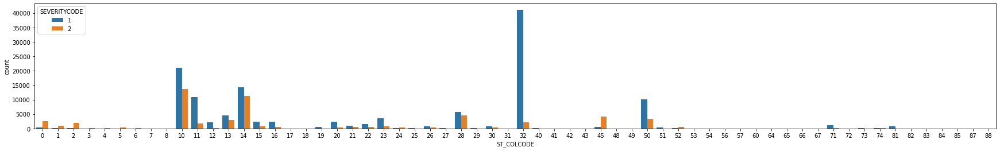

In [476]:
plt.figure(figsize = (30,4))
sns.countplot(pre_data['ST_COLCODE'], hue = pre_data['SEVERITYCODE'])

#### SEGLANEKEY
Long - A key for the lane segment in which the collision occurred. 

In [477]:
pre_data['SEGLANEKEY'].unique()

array([    0,  6855, 25242, ..., 42190, 11583, 10319], dtype=int64)

In [478]:
pre_data['SEGLANEKEY'].isna().sum()

0

In [479]:
pre_data[pre_data['SEGLANEKEY'] == 0]['SEGLANEKEY'].count()

185220

We have quite a lot of missing SEGLANEKEY information. We'll drop this column.

In [480]:
pre_data.drop('SEGLANEKEY', axis = 1, inplace = True)

#### CROSSWALKKEY
Long - A key for the crosswalk at which the collision occurred. 

In [481]:
pre_data['CROSSWALKKEY'].unique()

array([     0, 520838, 521466, ..., 525046, 523792, 523322], dtype=int64)

In [482]:
pre_data['CROSSWALKKEY'].isna().sum()

0

In [483]:
pre_data[pre_data['CROSSWALKKEY'] == 0]['CROSSWALKKEY'].count()

184187

Again there is a lot of rows with missing CROSSWALKKEY (0), so we'll drop this column too.

In [484]:
pre_data.drop('CROSSWALKKEY', axis = 1, inplace = True)

#### HITPARKEDCAR
Text, 1 - Whether or not the collision involved hitting a parked car. (Y/N) 

In [485]:
pre_data['HITPARKEDCAR'].unique()

array([&#39;N&#39;, &#39;Y&#39;], dtype=object)

We'll convert HITPARKEDCAR into binary data by replacing the values with 0 and 1.

In [486]:


pre_data['HITPARKEDCAR'].replace(['N', 'Y'], [0, 1], inplace = True)
pre_data['HITPARKEDCAR'].unique()

array([0, 1], dtype=int64)

&lt;AxesSubplot:xlabel=&#39;HITPARKEDCAR&#39;, ylabel=&#39;count&#39;&gt;

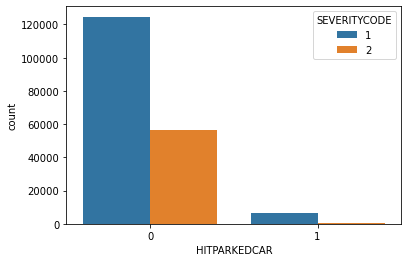

In [487]:
sns.countplot(pre_data['HITPARKEDCAR'], hue = pre_data['SEVERITYCODE'])

#### Let's review the data again

In [488]:
pre_data.head()

,SEVERITYCODE,ADDRTYPE,PERSONCOUNT,SDOT_COLCODE,INATTENTIONIND,UNDERINFL,WEATHER,ROADCOND,LIGHTCOND,SPEEDING,ST_COLCODE,HITPARKEDCAR
0,2,Intersection,2,11,0,0,Overcast,Wet,Daylight,0,10,0
1,1,Block,2,16,0,0,Raining,Wet,Dark,0,11,0
2,1,Block,4,14,0,0,Overcast,Dry,Daylight,0,32,0
3,1,Block,3,11,0,0,Clear,Dry,Daylight,0,23,0
4,2,Intersection,2,11,0,0,Raining,Wet,Daylight,0,10,0


In [489]:
len(pre_data)

187950

In [490]:
pre_data.info()

&lt;class &#39;pandas.core.frame.DataFrame&#39;&gt;
Int64Index: 187950 entries, 0 to 194672
Data columns (total 12 columns):
 #   Column          Non-Null Count   Dtype 
---  ------          --------------   ----- 
 0   SEVERITYCODE    187950 non-null  int64 
 1   ADDRTYPE        187950 non-null  object
 2   PERSONCOUNT     187950 non-null  int64 
 3   SDOT_COLCODE    187950 non-null  int64 
 4   INATTENTIONIND  187950 non-null  int64 
 5   UNDERINFL       187950 non-null  int64 
 6   WEATHER         187950 non-null  object
 7   ROADCOND        187950 non-null  object
 8   LIGHTCOND       187950 non-null  object
 9   SPEEDING        187950 non-null  int64 
 10  ST_COLCODE      187950 non-null  int64 
 11  HITPARKEDCAR    187950 non-null  int64 
dtypes: int64(8), object(4)
memory usage: 23.6+ MB


## 3. Preparing the Data for Training

#### 3.a. One-Hot Encoding

First, we need to encode categorical features WEATHER, ROADCOND, and LIGHTCOND into numerical values using one-hot encoding technique. We'll use get_dummies function from pandas package for this.

In [491]:
addrtype_dummy = pd.get_dummies(pre_data['ADDRTYPE']).drop('Alley', axis = 1)
weather_dummy = pd.get_dummies(pre_data['WEATHER']).drop('Other', axis = 1)
roadcond_dummy = pd.get_dummies(pre_data['ROADCOND']).drop('Other', axis = 1)
lightcond_dummy = pd.get_dummies(pre_data['LIGHTCOND']).drop('Other', axis = 1)

In [492]:
pre_data = pd.concat([pre_data, addrtype_dummy, weather_dummy, roadcond_dummy, lightcond_dummy], axis = 1)
pre_data.head()

,SEVERITYCODE,ADDRTYPE,PERSONCOUNT,SDOT_COLCODE,INATTENTIONIND,UNDERINFL,WEATHER,ROADCOND,LIGHTCOND,SPEEDING,...,Snowing,Dry,Oil,Sand/Mud/Dirt,Snow/Ice,Wet,Dark,Dawn,Daylight,Dusk
0,2,Intersection,2,11,0,0,Overcast,Wet,Daylight,0,...,0,0,0,0,0,1,0,0,1,0
1,1,Block,2,16,0,0,Raining,Wet,Dark,0,...,0,0,0,0,0,1,1,0,0,0
2,1,Block,4,14,0,0,Overcast,Dry,Daylight,0,...,0,1,0,0,0,0,0,0,1,0
3,1,Block,3,11,0,0,Clear,Dry,Daylight,0,...,0,1,0,0,0,0,0,0,1,0
4,2,Intersection,2,11,0,0,Raining,Wet,Daylight,0,...,0,0,0,0,0,1,0,0,1,0


We'll drop ADDRTYPE, WEATHER, ROADCOND, and LIGHTCOND since we already have generated the dummy features from them.

In [493]:
pre_data.drop(['ADDRTYPE', 'WEATHER', 'ROADCOND', 'LIGHTCOND'], axis = 1, inplace = True)
pre_data.head()

,SEVERITYCODE,PERSONCOUNT,SDOT_COLCODE,INATTENTIONIND,UNDERINFL,SPEEDING,ST_COLCODE,HITPARKEDCAR,Block,Intersection,...,Snowing,Dry,Oil,Sand/Mud/Dirt,Snow/Ice,Wet,Dark,Dawn,Daylight,Dusk
0,2,2,11,0,0,0,10,0,0,1,...,0,0,0,0,0,1,0,0,1,0
1,1,2,16,0,0,0,11,0,1,0,...,0,0,0,0,0,1,1,0,0,0
2,1,4,14,0,0,0,32,0,1,0,...,0,1,0,0,0,0,0,0,1,0
3,1,3,11,0,0,0,23,0,1,0,...,0,1,0,0,0,0,0,0,1,0
4,2,2,11,0,0,0,10,0,0,1,...,0,0,0,0,0,1,0,0,1,0


### 3.b. Train, Test Split

Now we'll split the data into training dataset and test dataset using test_train_split function.

In [494]:
X = pre_data.loc[:,'PERSONCOUNT':]
y = pre_data['SEVERITYCODE']

In [495]:
from sklearn.model_selection import train_test_split
from sklearn import metrics

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [496]:
print('X_train.shape() = ', X_train.shape, ', y_train.shape() = ', y_train.shape)
print('X_test.shape()  = ', X_test.shape, ', y_test.shape()  = ', y_test.shape)

X_train.shape() =  (125926, 27) , y_train.shape() =  (125926,)
X_test.shape()  =  (62024, 27) , y_test.shape()  =  (62024,)


&lt;AxesSubplot:xlabel=&#39;SEVERITYCODE&#39;, ylabel=&#39;count&#39;&gt;

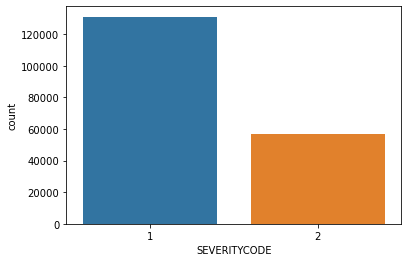

In [497]:
sns.countplot(pre_data['SEVERITYCODE'])

&lt;AxesSubplot:xlabel=&#39;SEVERITYCODE&#39;, ylabel=&#39;count&#39;&gt;

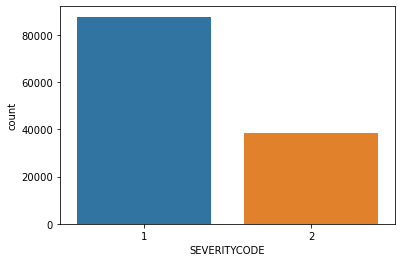

In [498]:
sns.countplot(y_train)

&lt;AxesSubplot:xlabel=&#39;SEVERITYCODE&#39;, ylabel=&#39;count&#39;&gt;

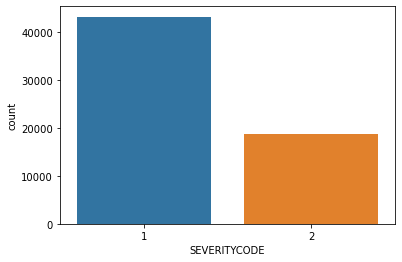

In [499]:
sns.countplot(y_test)

Since the data is skewed toward, SEVERITYCODE = 1, we will upsample the data for SEVERITYCODE = 2. We will do this for our training dataset.

First we will need to recombine X_train and y_train using pd.concat.

In [500]:

X_train = pd.concat([X_train, y_train], axis = 1)
X_train.head()

,PERSONCOUNT,SDOT_COLCODE,INATTENTIONIND,UNDERINFL,SPEEDING,ST_COLCODE,HITPARKEDCAR,Block,Intersection,Blowing Sand/Dirt,...,Dry,Oil,Sand/Mud/Dirt,Snow/Ice,Wet,Dark,Dawn,Daylight,Dusk,SEVERITYCODE
164180,4,11,1,0,0,10,0,0,1,0,...,1,0,0,0,0,0,0,1,0,1
97934,5,11,0,0,0,20,0,1,0,0,...,0,0,0,0,1,0,1,0,0,1
118892,1,0,1,0,0,50,0,1,0,0,...,0,0,0,0,1,1,0,0,0,1
31489,2,14,0,0,0,12,0,0,1,0,...,1,0,0,0,0,0,0,1,0,1
171344,1,28,0,1,0,50,0,0,1,0,...,1,0,0,0,0,1,0,0,0,2


In [501]:
print('SEVERITYCODE 1 = ',X_train[X_train['SEVERITYCODE'] == 1]['SEVERITYCODE'].count())
print('SEVERITYCODE 2 = ',X_train[X_train['SEVERITYCODE'] == 2]['SEVERITYCODE'].count())

SEVERITYCODE 1 =  87675
SEVERITYCODE 2 =  38251


Then we will upsample the data for SEVERITYCODE 2 using resample function from sklearn.

In [502]:
from sklearn.utils import resample

X_1 = X_train[X_train['SEVERITYCODE'] == 1]
X_2 = X_train[X_train['SEVERITYCODE'] == 2]

X_2_upsample = resample(X_2, replace=True, n_samples=len(X_1), random_state=42)
len(X_2_upsample)

87675

Next we combine X_1 and X_2_upsample.

In [503]:
X_train_upsample = pd.concat([X_1, X_2_upsample], axis = 0)
len(X_train_upsample)

175350

And split it again into X_train and y_train.

In [504]:
y_train_upsample = X_train_upsample['SEVERITYCODE']
X_train_upsample.drop('SEVERITYCODE', axis = 1, inplace = True)

In [505]:
y_train_upsample

164180    1
97934     1
118892    1
31489     1
190029    1
         ..
52582     2
191122    2
164289    2
134326    2
50437     2
Name: SEVERITYCODE, Length: 175350, dtype: int64

In [506]:
X_train_upsample

,PERSONCOUNT,SDOT_COLCODE,INATTENTIONIND,UNDERINFL,SPEEDING,ST_COLCODE,HITPARKEDCAR,Block,Intersection,Blowing Sand/Dirt,...,Snowing,Dry,Oil,Sand/Mud/Dirt,Snow/Ice,Wet,Dark,Dawn,Daylight,Dusk
164180,4,11,1,0,0,10,0,0,1,0,...,0,1,0,0,0,0,0,0,1,0
97934,5,11,0,0,0,20,0,1,0,0,...,0,0,0,0,0,1,0,1,0,0
118892,1,0,1,0,0,50,0,1,0,0,...,0,0,0,0,0,1,1,0,0,0
31489,2,14,0,0,0,12,0,0,1,0,...,0,1,0,0,0,0,0,0,1,0
190029,1,28,0,0,0,50,0,1,0,0,...,0,1,0,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52582,2,11,0,0,0,22,0,1,0,0,...,0,1,0,0,0,0,0,0,1,0
191122,2,51,0,0,0,5,0,0,1,0,...,0,1,0,0,0,0,0,0,1,0
164289,3,14,1,0,0,14,0,1,0,0,...,0,1,0,0,0,0,0,0,1,0
134326,3,11,0,0,0,28,0,0,1,0,...,0,0,0,0,0,1,0,0,1,0


## 4. Model Building

Due to computanional limitation, we will only use Logistic Regression, Decision Tree, and Support Vector Machine for the models. 

### 4.a. Logistic Regression


In [507]:
from sklearn.linear_model import LogisticRegression

mod_log_r = LogisticRegression()
mod_log_r.fit(X_train_upsample, y_train_upsample)
yhat_log_r = mod_log_r.predict(X_test)
yhat_log_r_proba = mod_log_r.predict_proba(X_test)
print("Logistic Regression's Accuracy: ", metrics.accuracy_score(y_test, yhat_log_r))

Logistic Regression&#39;s Accuracy:  0.6494421514252547


### 4.b. Decision Tree

In [510]:
from sklearn.tree import DecisionTreeClassifier

mod_tree = DecisionTreeClassifier(criterion="entropy", max_depth = 4).fit(X_train_upsample, y_train_upsample)
yhat_tree = mod_tree.predict(X_test)
print("Decision Trees's Accuracy: ", metrics.accuracy_score(y_test, yhat_tree))

Decision Trees&#39;s Accuracy:  0.7171739971623887


### 4.c. Support Vector Machine

In [516]:
from sklearn import svm

mod_svm = svm.SVC(kernel='rbf', gamma = 'scale').fit(X_train_upsample, y_train_upsample)
yhat_svm = mod_svm.predict(X_test)
print("Decision Trees's Accuracy: ", metrics.accuracy_score(y_test, yhat_svm))

Decision Trees&#39;s Accuracy:  0.6362859538243261


## 5. Model Evaluation

In [517]:
from sklearn.metrics import jaccard_score
from sklearn.metrics import f1_score

report = pd.DataFrame(index = ['LogisticRegression', 'Decision Tree', 'SVM'], columns = ['Jaccard', 'F1-score'])

report.loc['LogisticRegression', 'Jaccard'] = jaccard_score(y_test, yhat_log_r)
report.loc['LogisticRegression', 'F1-score'] = f1_score(y_test, yhat_log_r, average = 'weighted')

report.loc['Decision Tree', 'Jaccard'] = jaccard_score(y_test, yhat_tree)
report.loc['Decision Tree', 'F1-score'] = f1_score(y_test, yhat_tree, average = 'weighted')

report.loc['SVM', 'Jaccard'] = jaccard_score(y_test, yhat_svm)
report.loc['SVM', 'F1-score'] = f1_score(y_test, yhat_svm, average = 'weighted')


report.index.name = 'Algorithm'
report

,Jaccard,F1-score
Algorithm,,
LogisticRegression,0.56196,0.663106
Decision Tree,0.659848,0.719192
SVM,0.522793,0.650411


Based on the scores, Decision Tree has the best performance out of all the three models that we build. 

We can also print out the confusion matrixes for each model.

In [519]:
print('Confusion Matrix for Logistic Regression:')
print(metrics.confusion_matrix(y_test, yhat_log_r))
print()
print('Confusion Matrix for Decision Tree:')
print(metrics.confusion_matrix(y_test, yhat_tree))
print()
print('Confusion Matrix for Support Vector Machine:')
print(metrics.confusion_matrix(y_test, yhat_svm))

Confusion Matrix for Logistic Regression:
[[27894 15404]
 [ 6339 12387]]

Confusion Matrix for Decision Tree:
[[34029  9269]
 [ 8273 10453]]

Confusion Matrix for Support Vector Machine:
[[24714 18584]
 [ 3975 14751]]


## 6. Conclusion

The data we use have an unbalanced number of SEVERITYCODE values and is heavily skewed toward SEVERITYCODE 1. Also, some of the lines are missing some information. Due to those, we needed to remove rows with missing information and resampled the training data to reinforce the signal of the data in the minor category (SEVERITYCODE 2).

With those limitations, we managed to build three classification models, Logistic Regression, Decision Tree, and Support Vector Machine, even though there are still room to improve the model’s performances.

Comparing the scores for those models, we have the Decision Tree model that gives us the best accuracy score. With better dataset, we sure can improve the performance of the model.